## DCGAN is one of the popular and successful network design for GAN. It mainly composes of convolution layers without max pooling or fully connected layers. It uses convolutional stride and transposed convolution for the downsampling and the upsampling. The figure below is the network design for the generator.
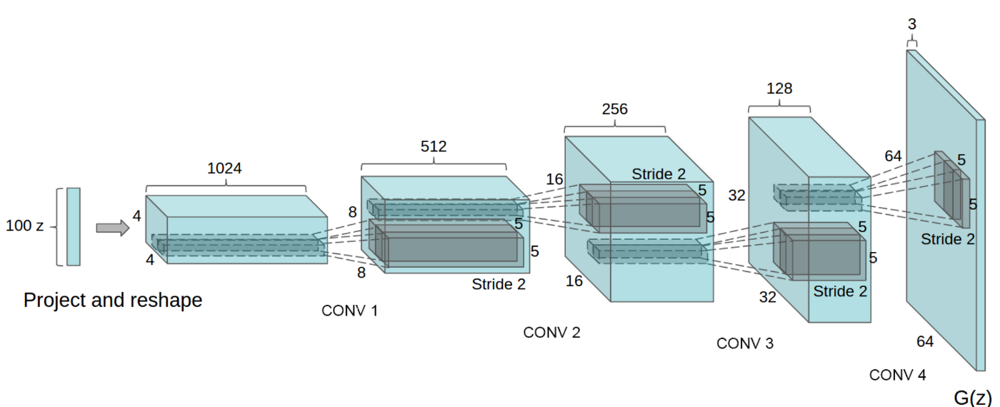
Reference: https://medium.com/@jonathan_hui/gan-dcgan-deep-convolutional-generative-adversarial-networks-df855c438f

# Process involved:
## In this notebook we have been given the data which contains faces of the different character of the simpsons. There are two-types of faces:
## 1. cropped
## 2. simplified
## The cropped faces contains the images of the faces directly cropped from a video. The simplified faces contains the simplest form of the cropped images(they only contain the outline and the color).
## Now, we have created two deep neural network, viz. Generator and Discriminator.
## The major three steps involved in the process are:
## 1. Using the generator to create fake inputs based on random noise or in our case, random normal noise.
## 2.Training the discriminator with both real and fake inputs (either simultaneously by concatenating real and fake inputs, or one after the other).
## 3. Training the whole model: the model is built with the discriminator combined with the generator.

# Minimax Representation
## The major algorithm involved behind the DCGAN is minimax representation.
## If we think once again about Discriminator’s and Generator’s goals, we can see that they are opposing each other. Discriminator’s success is a Generator’s failure and vice-versa. That is why we can represent GANs framework more like Minimax game framework rather than an optimization problem.
Reference: https://medium.com/@jonathan_hui/gan-whats-generative-adversarial-networks-and-its-application-f39ed278ef09

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/simpsons-faces/cropped/7592.png
/kaggle/input/simpsons-faces/cropped/7494.png
/kaggle/input/simpsons-faces/cropped/3798.png
/kaggle/input/simpsons-faces/cropped/9554.png
/kaggle/input/simpsons-faces/cropped/1554.png
/kaggle/input/simpsons-faces/cropped/4242.png
/kaggle/input/simpsons-faces/cropped/2288.png
/kaggle/input/simpsons-faces/cropped/3850.png
/kaggle/input/simpsons-faces/cropped/7129.png
/kaggle/input/simpsons-faces/cropped/605.png
/kaggle/input/simpsons-faces/cropped/7956.png
/kaggle/input/simpsons-faces/cropped/8795.png
/kaggle/input/simpsons-faces/cropped/9779.png
/kaggle/input/simpsons-faces/cropped/9781.png
/kaggle/input/simpsons-faces/cropped/2135.png
/kaggle/input/simpsons-faces/cropped/7642.png
/kaggle/input/simpsons-faces/cropped/2533.png
/kaggle/input/simpsons-faces/cropped/2774.png
/kaggle/input/simpsons-faces/cropped/8811.png
/kaggle/input/simpsons-faces/cropped/1717.png
/kaggle/input/simpsons-faces/cropped/7208.png
/kaggle/input/simpsons-faces/croppe

In [2]:
import os
import time
import tensorflow as tf
import numpy as np
from glob import glob
import datetime
import random
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

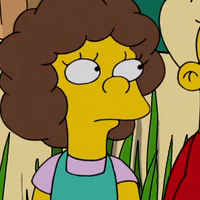

In [4]:
import PIL
image="../input/simpsons-faces/cropped/1008.png"
img=PIL.Image.open(image)
img

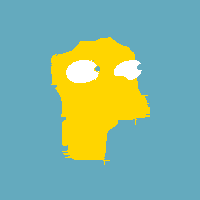

In [5]:
image="../input/simpsons-faces/simplified/1008.png"
img=PIL.Image.open(image)
img

In [6]:
def generator(z, output_channel_dim, training):
    with tf.variable_scope("generator", reuse= not training):
        
        # 8x8x1024
        fully_connected = tf.layers.dense(z, 8*8*1024)
        fully_connected = tf.reshape(fully_connected, (-1, 8, 8, 1024))
        fully_connected = tf.nn.leaky_relu(fully_connected)

        # 8x8x1024 -> 16x16x512
        trans_conv1 = tf.layers.conv2d_transpose(inputs=fully_connected,
                                                 filters=512,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 name="trans_conv1")
        batch_trans_conv1 = tf.layers.batch_normalization(inputs = trans_conv1,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv1")
        trans_conv1_out = tf.nn.leaky_relu(batch_trans_conv1,
                                           name="trans_conv1_out")
        
        # 16x16x512 -> 32x32x256
        trans_conv2 = tf.layers.conv2d_transpose(inputs=trans_conv1_out,
                                                 filters=256,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 name="trans_conv2")
        batch_trans_conv2 = tf.layers.batch_normalization(inputs = trans_conv2,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv2")
        trans_conv2_out = tf.nn.leaky_relu(batch_trans_conv2,
                                           name="trans_conv2_out")
        
        # 32x32x256 -> 64x64x128
        trans_conv3 = tf.layers.conv2d_transpose(inputs=trans_conv2_out,
                                                 filters=128,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 name="trans_conv3")
        batch_trans_conv3 = tf.layers.batch_normalization(inputs = trans_conv3,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv3")
        trans_conv3_out = tf.nn.leaky_relu(batch_trans_conv3,
                                           name="trans_conv3_out")
        
        # 64x64x128 -> 128x128x64
        trans_conv4 = tf.layers.conv2d_transpose(inputs=trans_conv3_out,
                                                 filters=64,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 name="trans_conv4")
        batch_trans_conv4 = tf.layers.batch_normalization(inputs = trans_conv4,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv4")
        trans_conv4_out = tf.nn.leaky_relu(batch_trans_conv4,
                                           name="trans_conv4_out")
        
        # 128x128x64 -> 128x128x3
        logits = tf.layers.conv2d_transpose(inputs=trans_conv4_out,
                                            filters=3,
                                            kernel_size=[5,5],
                                            strides=[1,1],
                                            padding="SAME",
                                            name="logits")
        out = tf.tanh(logits, name="out")
        return out

In [7]:
def discriminator(x, reuse):
    with tf.variable_scope("discriminator", reuse=reuse): 
        
        # 128*128*3 -> 64x64x64 
        conv1 = tf.layers.conv2d(inputs=x,
                                 filters=64,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding="SAME",
                                 name='conv1')
        batch_norm1 = tf.layers.batch_normalization(conv1,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm1')
        conv1_out = tf.nn.leaky_relu(batch_norm1,
                                     name="conv1_out")
        
        # 64x64x64-> 32x32x128 
        conv2 = tf.layers.conv2d(inputs=conv1_out,
                                 filters=128,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 name='conv2')
        batch_norm2 = tf.layers.batch_normalization(conv2,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm2')
        conv2_out = tf.nn.leaky_relu(batch_norm2,
                                     name="conv2_out")
        
        # 32x32x128 -> 16x16x256  
        conv3 = tf.layers.conv2d(inputs=conv2_out,
                                 filters=256,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 name='conv3')
        batch_norm3 = tf.layers.batch_normalization(conv3,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm3')
        conv3_out = tf.nn.leaky_relu(batch_norm3,
                                     name="conv3_out")
        
        # 16x16x256 -> 16x16x512
        conv4 = tf.layers.conv2d(inputs=conv3_out,
                                 filters=512,
                                 kernel_size=[5, 5],
                                 strides=[1, 1],
                                 padding="SAME",
                                 name='conv4')
        batch_norm4 = tf.layers.batch_normalization(conv4,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm4')
        conv4_out = tf.nn.leaky_relu(batch_norm4,
                                     name="conv4_out")
        
        # 16x16x512 -> 8x8x1024
        conv5 = tf.layers.conv2d(inputs=conv4_out,
                                filters=1024,
                                kernel_size=[5, 5],
                                strides=[2, 2],
                                padding="SAME",
                                name='conv5')
        batch_norm5 = tf.layers.batch_normalization(conv5,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm5')
        conv5_out = tf.nn.leaky_relu(batch_norm5,
                                     name="conv5_out")

        flatten = tf.reshape(conv5_out, (-1, 8*8*1024))
        logits = tf.layers.dense(inputs=flatten,
                                 units=1,
                                 activation=None)
        out = tf.sigmoid(logits)
        return out, logits

In [8]:
def model_loss(input_real, input_z, output_channel_dim):
    g_model = generator(input_z, output_channel_dim, True)

    noisy_input_real = input_real + tf.random_normal(shape=tf.shape(input_real),
                                                     mean=0.0,
                                                     stddev=random.uniform(0.0, 0.1),
                                                     dtype=tf.float32)
    
    d_model_real, d_logits_real = discriminator(noisy_input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=tf.ones_like(d_model_real)*random.uniform(0.9, 1.0)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=tf.zeros_like(d_model_fake)))
    d_loss = tf.reduce_mean(0.5 * (d_loss_real + d_loss_fake))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                    labels=tf.ones_like(d_model_fake)))
    return d_loss, g_loss

In [9]:
def model_optimizers(d_loss, g_loss):
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith("generator")]
    d_vars = [var for var in t_vars if var.name.startswith("discriminator")]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    gen_updates = [op for op in update_ops if op.name.startswith('generator')]
    
    with tf.control_dependencies(gen_updates):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=LR_D, beta1=BETA1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate=LR_G, beta1=BETA1).minimize(g_loss, var_list=g_vars)  
    return d_train_opt, g_train_opt

In [10]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name="input_z")
    learning_rate_G = tf.placeholder(tf.float32, name="lr_g")
    learning_rate_D = tf.placeholder(tf.float32, name="lr_d")
    return inputs_real, inputs_z, learning_rate_G, learning_rate_D

In [11]:
def show_samples(sample_images, name, epoch):
    figure, axes = plt.subplots(1, len(sample_images), figsize = (IMAGE_SIZE, IMAGE_SIZE))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample_images[index]
        axis.imshow(image_array)
        image = Image.fromarray(image_array)
        image.save(name+"_"+str(epoch)+"_"+str(index)+".png") 
    plt.savefig(name+"_"+str(epoch)+".png", bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [12]:
def test(sess, input_z, out_channel_dim, epoch):
    example_z = np.random.uniform(-1, 1, size=[SAMPLES_TO_SHOW, input_z.get_shape().as_list()[-1]])
    samples = sess.run(generator(input_z, out_channel_dim, False), feed_dict={input_z: example_z})
    sample_images = [((sample + 1.0) * 127.5).astype(np.uint8) for sample in samples]
    show_samples(sample_images, OUTPUT_DIR + "samples", epoch)

In [13]:
def summarize_epoch(epoch, duration, sess, d_losses, g_losses, input_z, data_shape):
    minibatch_size = int(data_shape[0]//BATCH_SIZE)
    print("Epoch {}/{}".format(epoch, EPOCHS),
          "\nDuration: {:.5f}".format(duration),
          "\nD Loss: {:.5f}".format(np.mean(d_losses[-minibatch_size:])),
          "\nG Loss: {:.5f}".format(np.mean(g_losses[-minibatch_size:])))
    fig, ax = plt.subplots()
    plt.plot(d_losses, label='Discriminator', alpha=0.6)
    plt.plot(g_losses, label='Generator', alpha=0.6)
    plt.title("Losses")
    plt.legend()
    plt.savefig(OUTPUT_DIR + "losses_" + str(epoch) + ".png")
    plt.show()
    plt.close()
    test(sess, input_z, data_shape[3], epoch)

In [14]:
def get_batches(data):
    batches = []
    for i in range(int(data.shape[0]//BATCH_SIZE)):
        batch = data[i * BATCH_SIZE:(i + 1) * BATCH_SIZE]
        augmented_images = []
        for img in batch:
            image = Image.fromarray(img)
            if random.choice([True, False]):
                image = image.transpose(Image.FLIP_LEFT_RIGHT)
            augmented_images.append(np.asarray(image))
        batch = np.asarray(augmented_images)
        normalized_batch = (batch / 127.5) - 1.0
        batches.append(normalized_batch)
    return batches

In [15]:
def train(get_batches, data_shape, checkpoint_to_load=None):
    input_images, input_z, lr_G, lr_D = model_inputs(data_shape[1:], NOISE_SIZE)
    d_loss, g_loss = model_loss(input_images, input_z, data_shape[3])
    d_opt, g_opt = model_optimizers(d_loss, g_loss)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        epoch = 0
        iteration = 0
        d_losses = []
        g_losses = []
        
        for epoch in range(EPOCHS):        
            epoch += 1
            start_time = time.time()

            for batch_images in get_batches:
                iteration += 1
                batch_z = np.random.uniform(-1, 1, size=(BATCH_SIZE, NOISE_SIZE))
                _ = sess.run(d_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_D: LR_D})
                _ = sess.run(g_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_G: LR_G})
                d_losses.append(d_loss.eval({input_z: batch_z, input_images: batch_images}))
                g_losses.append(g_loss.eval({input_z: batch_z}))

            summarize_epoch(epoch, time.time()-start_time, sess, d_losses, g_losses, input_z, data_shape)

In [16]:
# Paths
INPUT_DATA_DIR = "../input/simpsons-faces/cropped/"
# OUTPUT_DIR = './{date:%Y-%m-%d_%H:%M:%S}/'.format(date=datetime.datetime.now())
# if not os.path.exists(OUTPUT_DIR):
#     os.makedirs(OUTPUT_DIR)
OUTPUT_DIR = ""

In [17]:
# Hyperparameters
IMAGE_SIZE = 128
NOISE_SIZE = 100
LR_D = 0.00004
LR_G = 0.0004
BATCH_SIZE = 32
EPOCHS = 50 # For better results increase this value 
BETA1 = 0.5
WEIGHT_INIT_STDDEV = 0.02
EPSILON = 0.00005
SAMPLES_TO_SHOW = 5

In [18]:
def add_noise(img):
    VARIABILITY=50
    deviation=VARIABILITY*random.random()
    noise=np.random.normal(0,deviation,img.shape)
    img+=noise
    np.clip(img,0.,255.)
    return(img)

Starting the training
Input: (9877, 128, 128, 3)


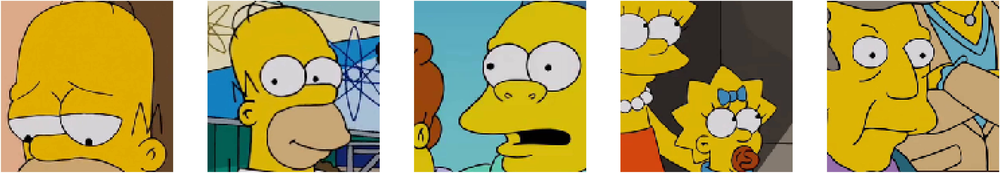

Epoch 1/50 
Duration: 151.18994 
D Loss: 1.61800 
G Loss: 0.37330


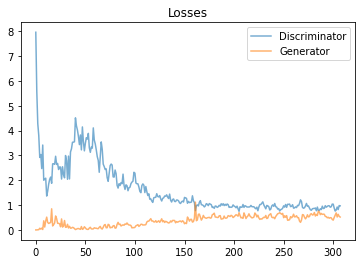

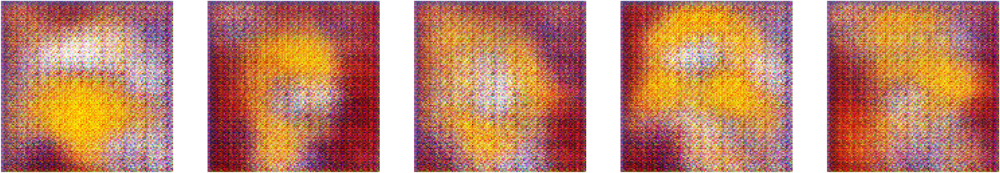

Epoch 2/50 
Duration: 145.65948 
D Loss: 0.81165 
G Loss: 0.64330


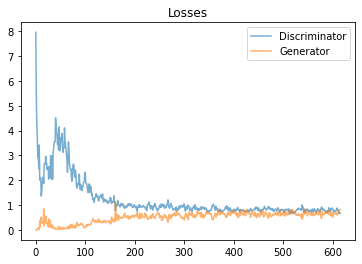

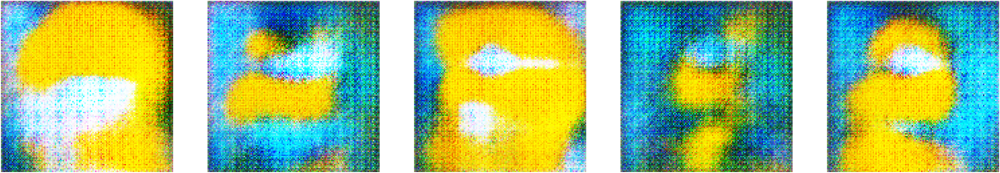

Epoch 3/50 
Duration: 145.83656 
D Loss: 0.78158 
G Loss: 0.66057


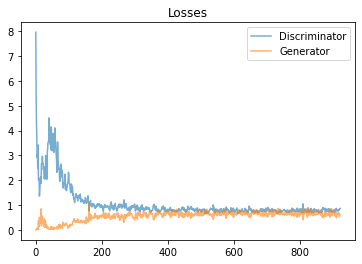

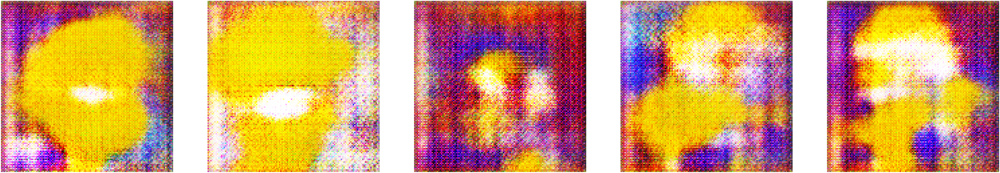

Epoch 4/50 
Duration: 145.81017 
D Loss: 0.74730 
G Loss: 0.69454


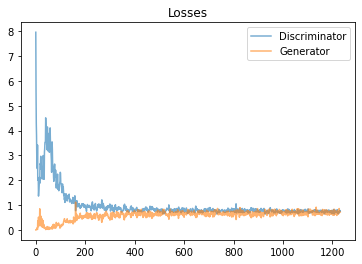

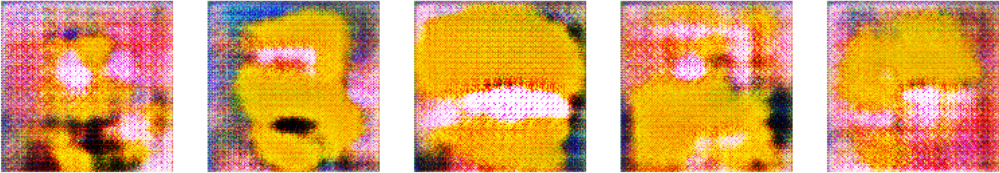

Epoch 5/50 
Duration: 144.65614 
D Loss: 0.73890 
G Loss: 0.70305


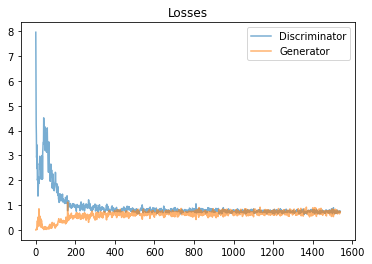

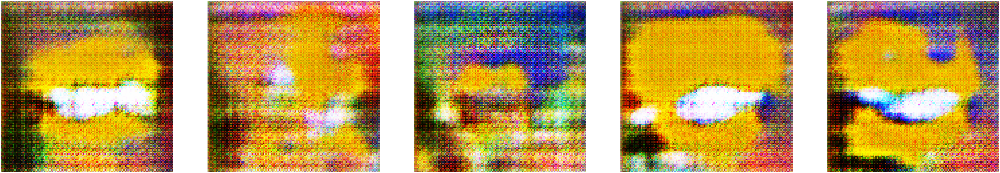

Epoch 6/50 
Duration: 145.85853 
D Loss: 0.73286 
G Loss: 0.70825


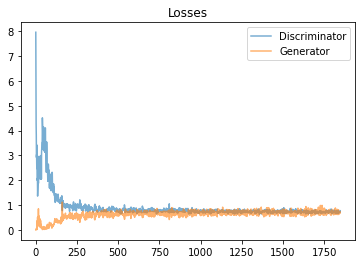

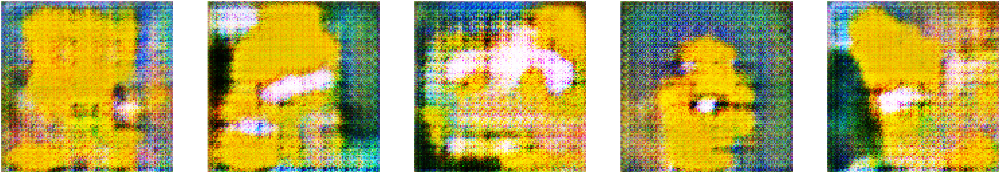

Epoch 7/50 
Duration: 145.77882 
D Loss: 0.72265 
G Loss: 0.71917


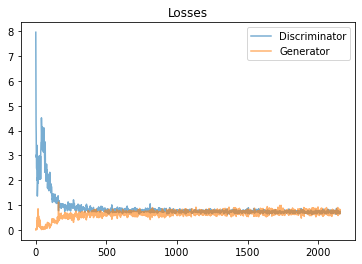

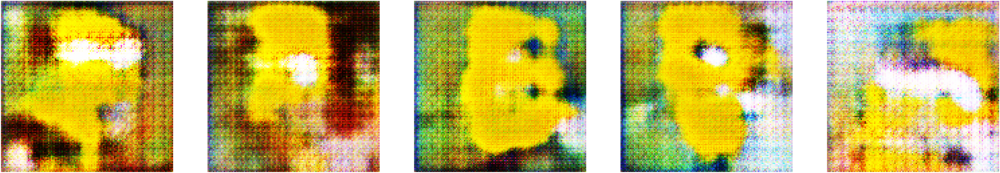

Epoch 8/50 
Duration: 145.83906 
D Loss: 0.71670 
G Loss: 0.72373


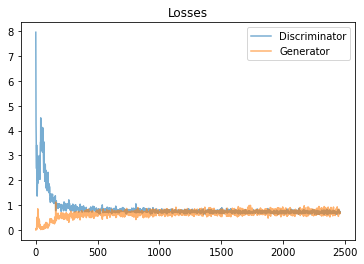

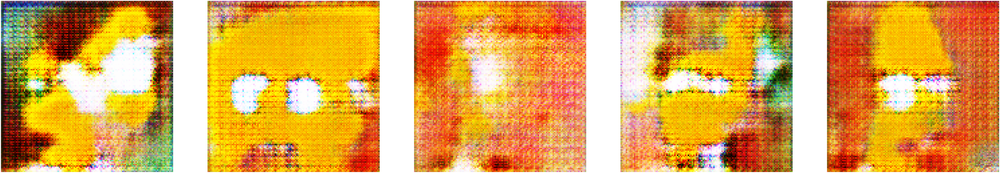

Epoch 9/50 
Duration: 145.64497 
D Loss: 0.70627 
G Loss: 0.74087


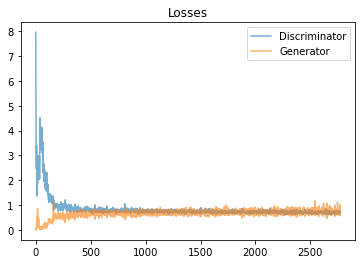

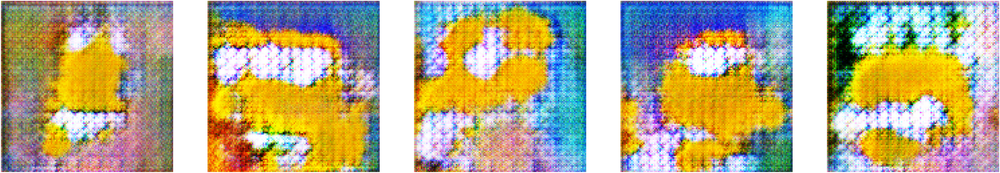

Epoch 10/50 
Duration: 145.82801 
D Loss: 0.69736 
G Loss: 0.75207


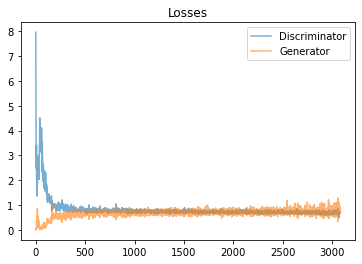

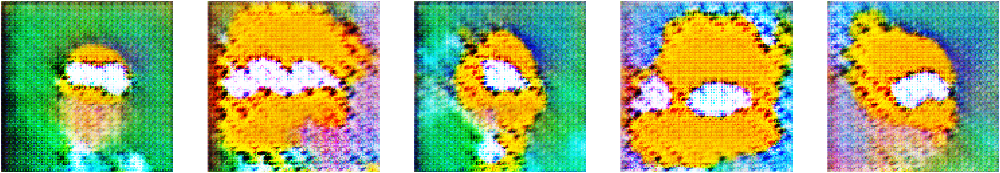

Epoch 11/50 
Duration: 145.81607 
D Loss: 0.68365 
G Loss: 0.80259


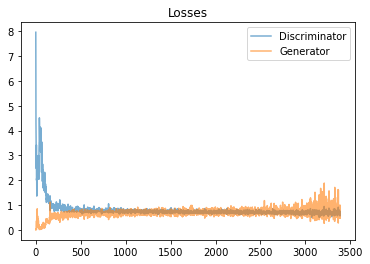

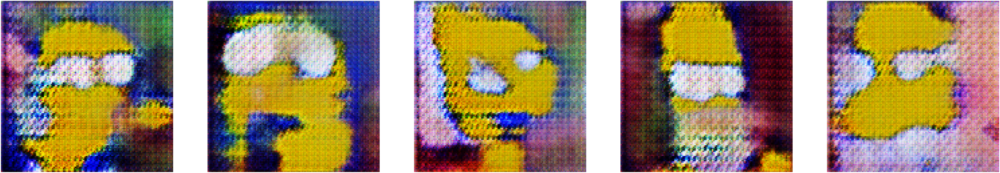

Epoch 12/50 
Duration: 145.80346 
D Loss: 0.69158 
G Loss: 0.74896


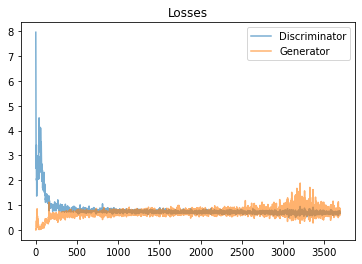

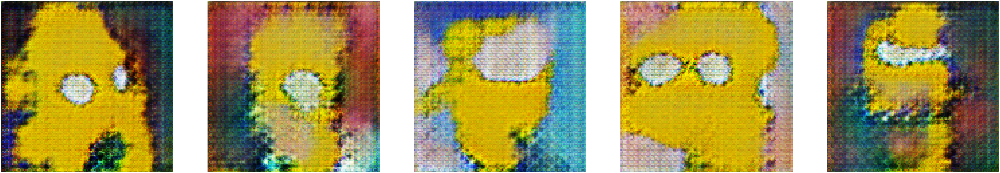

Epoch 13/50 
Duration: 145.68347 
D Loss: 0.68950 
G Loss: 0.74434


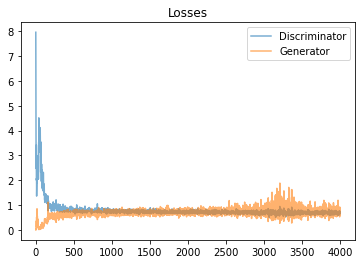

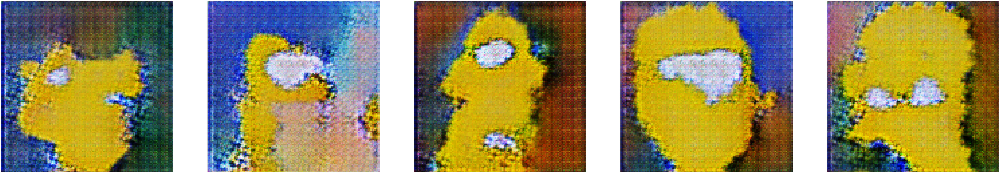

Epoch 14/50 
Duration: 145.81546 
D Loss: 0.68159 
G Loss: 0.76625


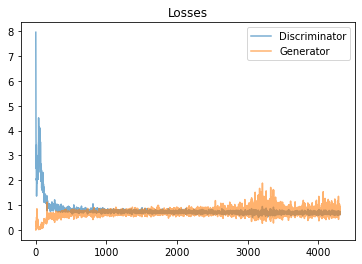

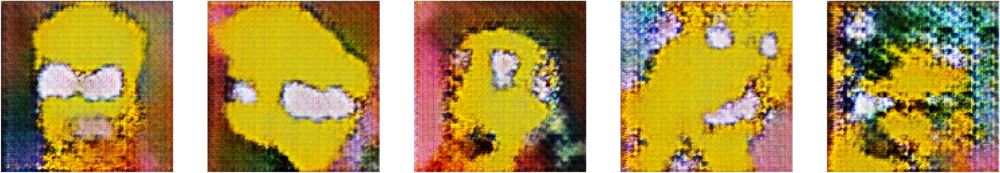

Epoch 15/50 
Duration: 145.73047 
D Loss: 0.67108 
G Loss: 0.77956


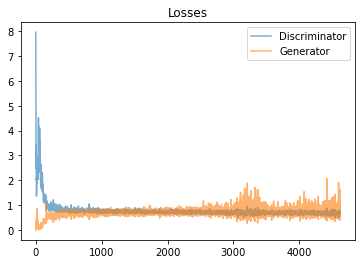

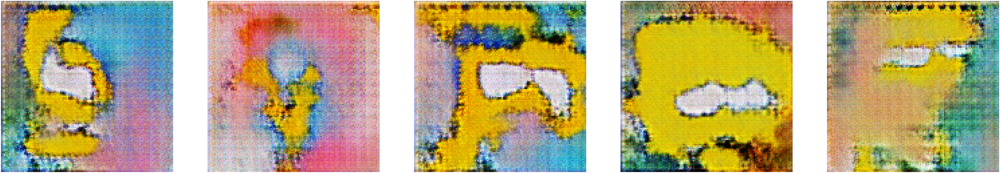

Epoch 16/50 
Duration: 145.72569 
D Loss: 0.66166 
G Loss: 0.79377


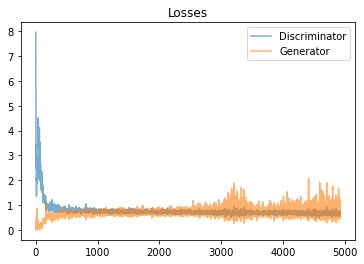

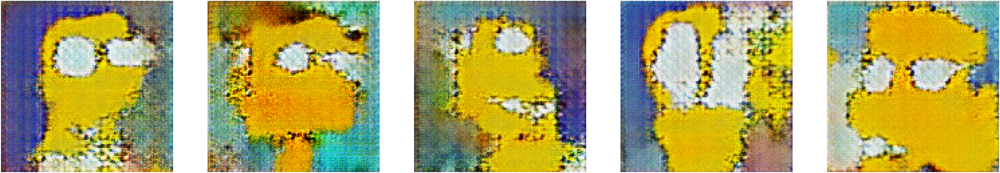

Epoch 17/50 
Duration: 144.61807 
D Loss: 0.65457 
G Loss: 0.81652


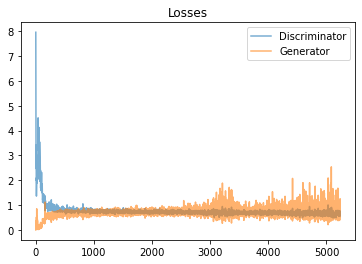

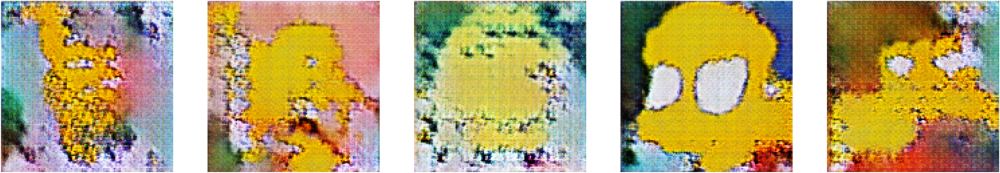

Epoch 18/50 
Duration: 144.55598 
D Loss: 0.64705 
G Loss: 0.81972


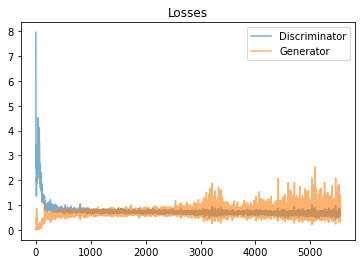

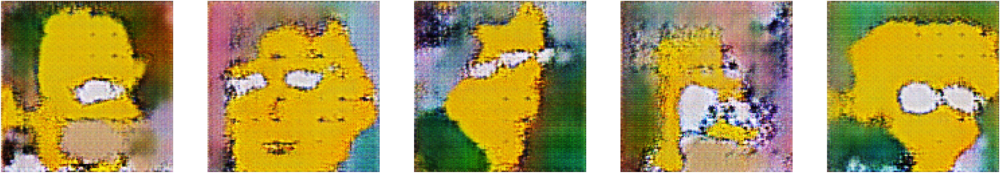

Epoch 19/50 
Duration: 145.44717 
D Loss: 0.64524 
G Loss: 0.80850


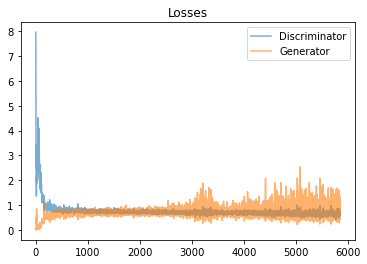

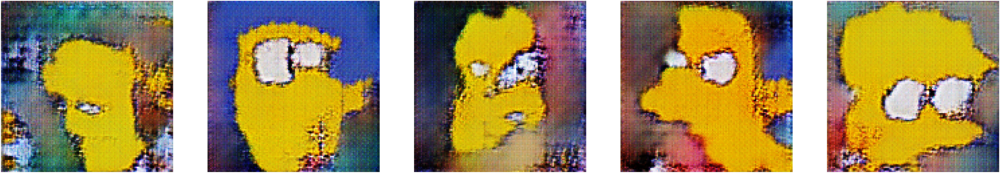

Epoch 20/50 
Duration: 145.42636 
D Loss: 0.63610 
G Loss: 0.82142


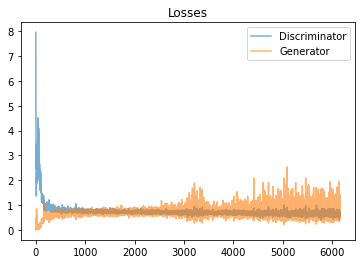

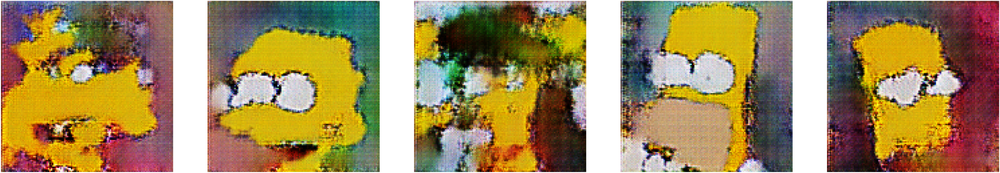

Epoch 21/50 
Duration: 145.37315 
D Loss: 0.62761 
G Loss: 0.83486


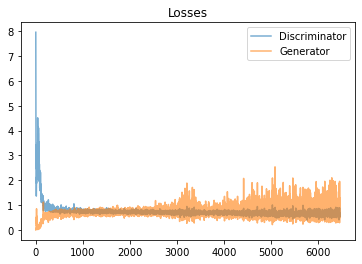

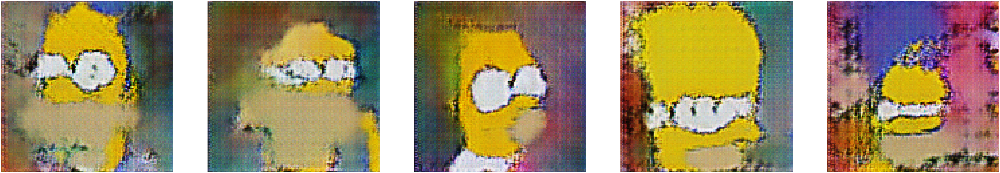

Epoch 22/50 
Duration: 144.40611 
D Loss: 0.61717 
G Loss: 0.86086


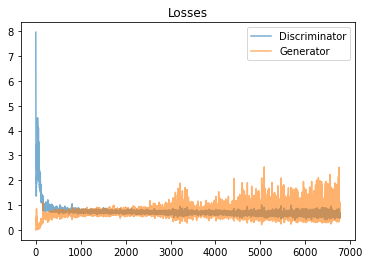

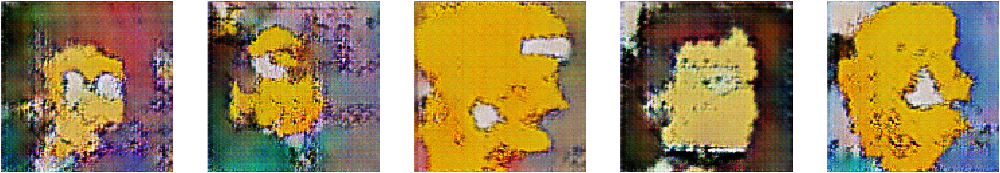

Epoch 23/50 
Duration: 145.49367 
D Loss: 0.61002 
G Loss: 0.85766


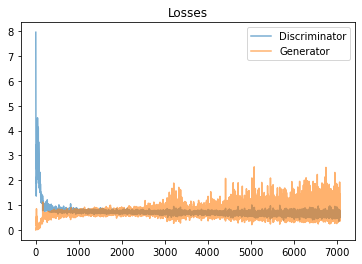

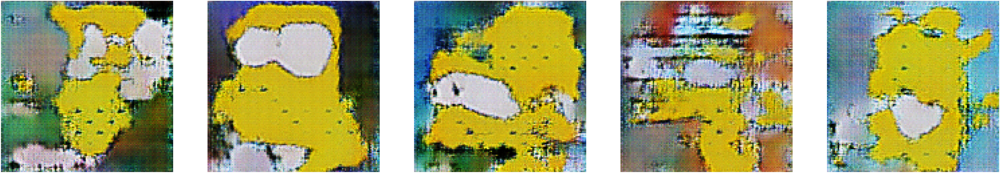

Epoch 24/50 
Duration: 145.58083 
D Loss: 0.59969 
G Loss: 0.89061


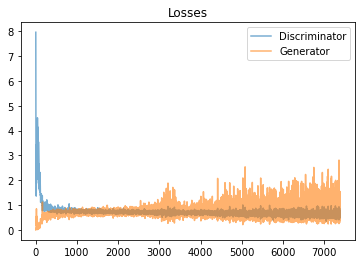

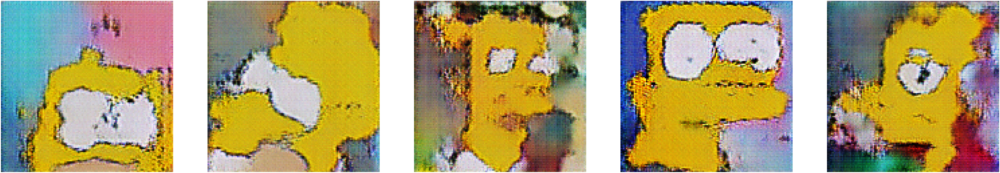

Epoch 25/50 
Duration: 145.44209 
D Loss: 0.58629 
G Loss: 0.91617


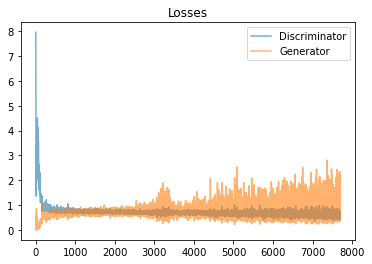

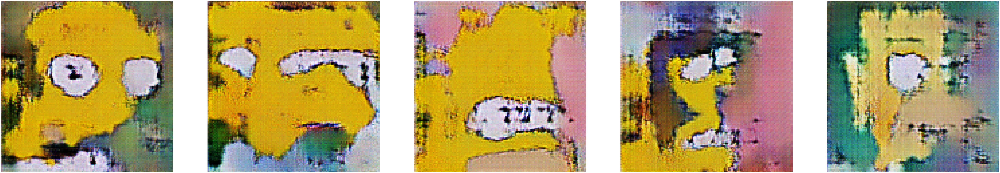

Epoch 26/50 
Duration: 145.50600 
D Loss: 0.57512 
G Loss: 0.95903


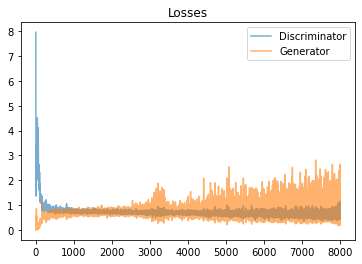

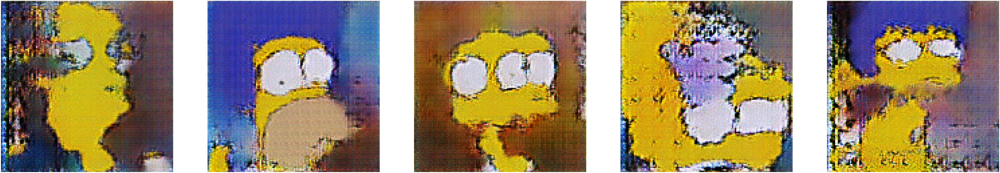

Epoch 27/50 
Duration: 145.48550 
D Loss: 0.55867 
G Loss: 0.98077


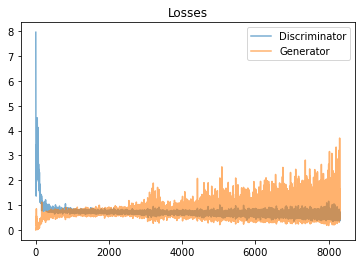

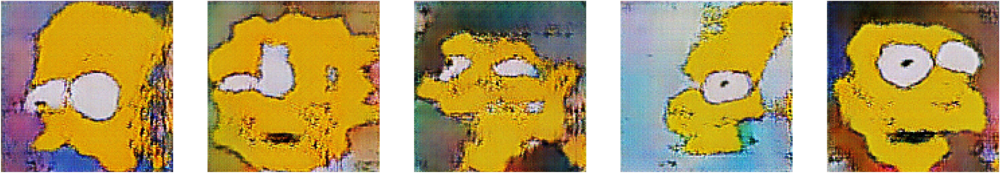

Epoch 28/50 
Duration: 145.93560 
D Loss: 0.55266 
G Loss: 1.02915


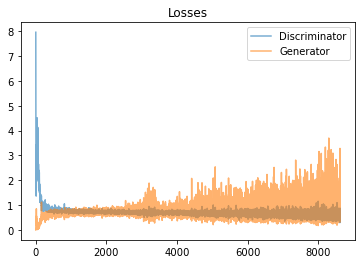

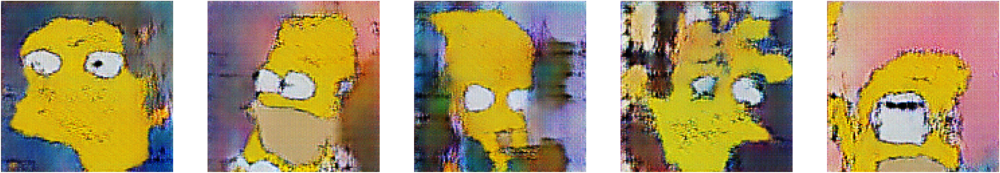

Epoch 29/50 
Duration: 145.67791 
D Loss: 0.53791 
G Loss: 1.07090


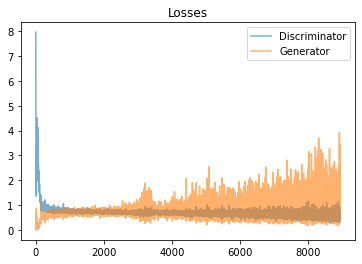

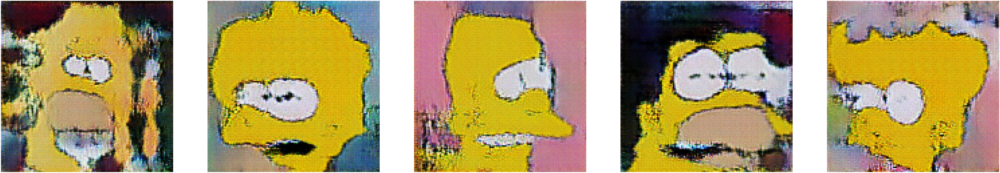

Epoch 30/50 
Duration: 144.69703 
D Loss: 0.53600 
G Loss: 1.06516


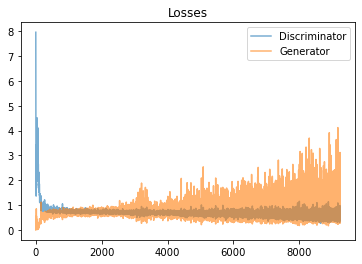

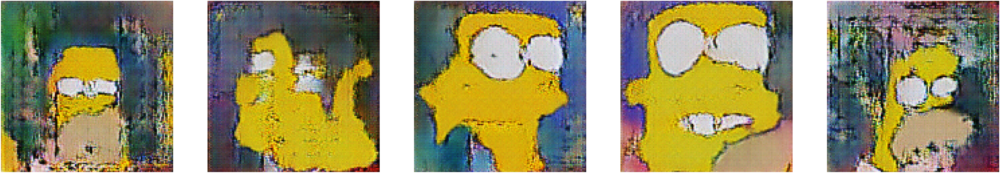

Epoch 31/50 
Duration: 144.50871 
D Loss: 0.51656 
G Loss: 1.10228


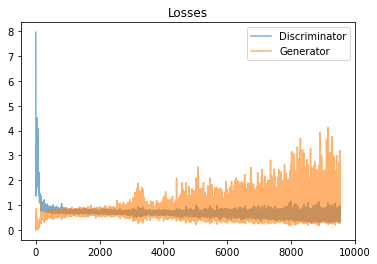

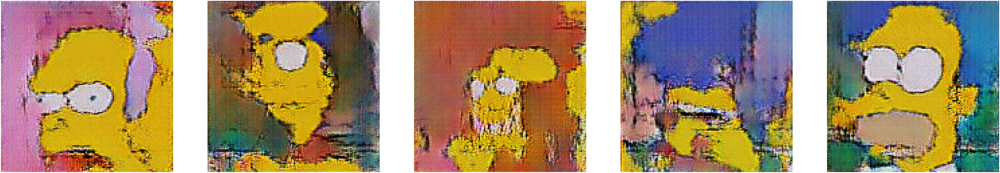

Epoch 32/50 
Duration: 144.57178 
D Loss: 0.51195 
G Loss: 1.14252


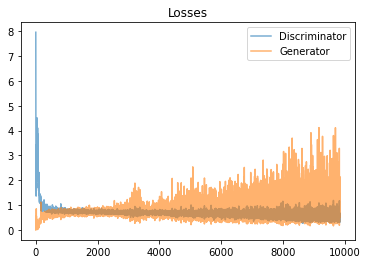

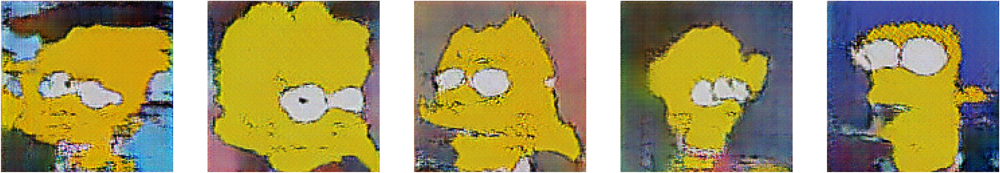

Epoch 33/50 
Duration: 144.61702 
D Loss: 0.49669 
G Loss: 1.16656


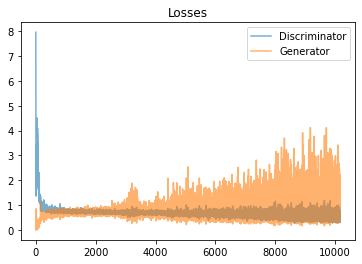

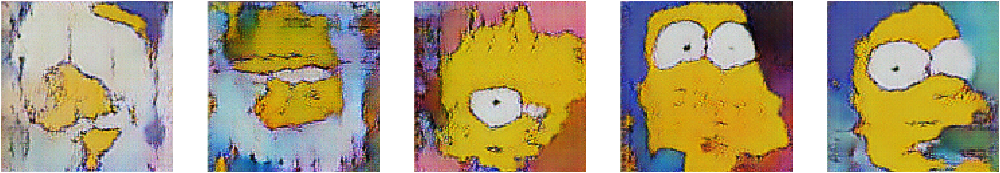

Epoch 34/50 
Duration: 145.55711 
D Loss: 0.48269 
G Loss: 1.21659


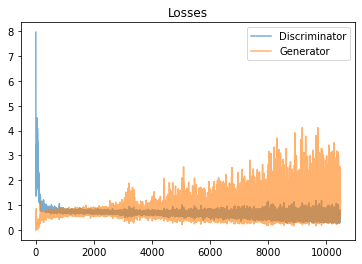

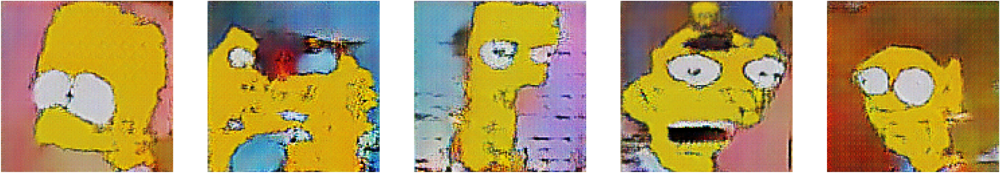

Epoch 35/50 
Duration: 145.63679 
D Loss: 0.49663 
G Loss: 1.22272


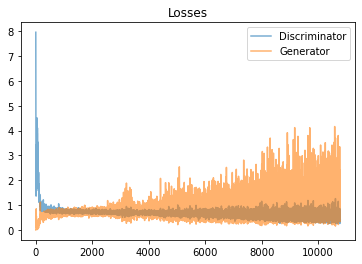

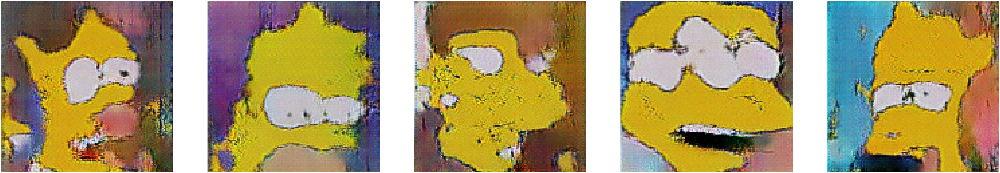

Epoch 36/50 
Duration: 145.43932 
D Loss: 0.47946 
G Loss: 1.25855


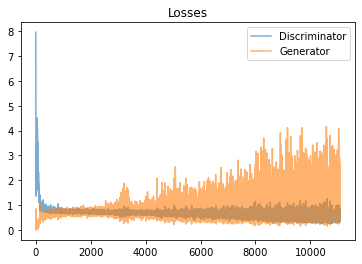

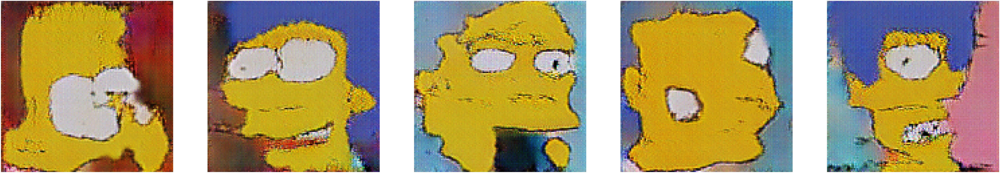

Epoch 37/50 
Duration: 145.08156 
D Loss: 0.47515 
G Loss: 1.28725


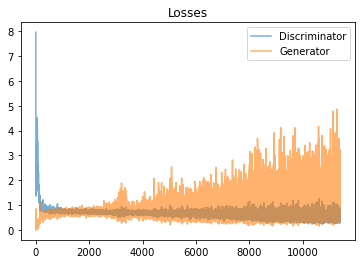

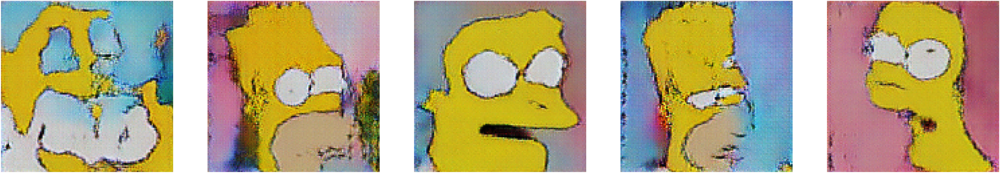

Epoch 38/50 
Duration: 145.44041 
D Loss: 0.45935 
G Loss: 1.30703


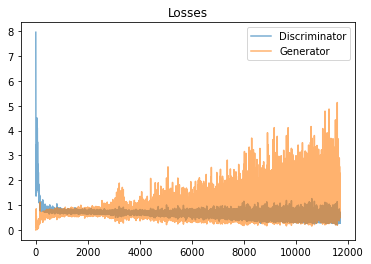

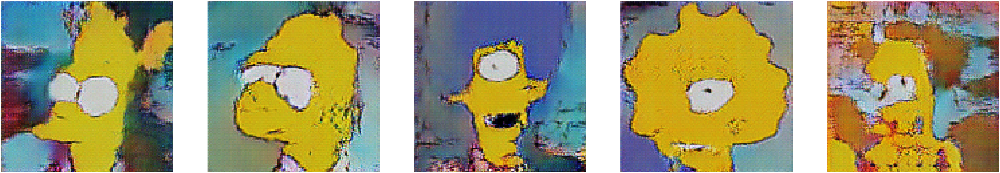

Epoch 39/50 
Duration: 145.30400 
D Loss: 0.44175 
G Loss: 1.38925


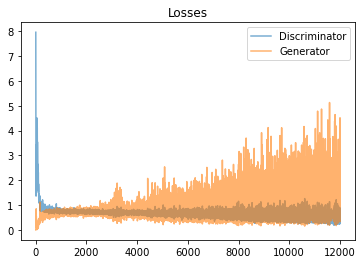

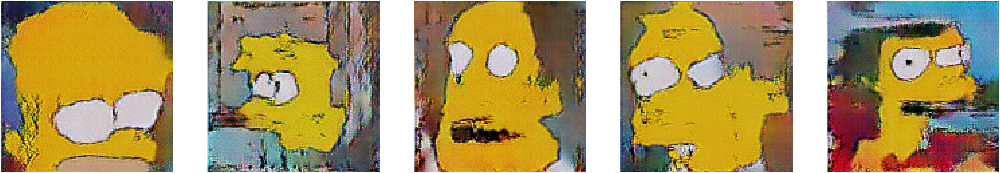

Epoch 40/50 
Duration: 145.42231 
D Loss: 0.44603 
G Loss: 1.42114


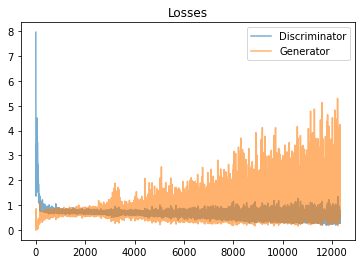

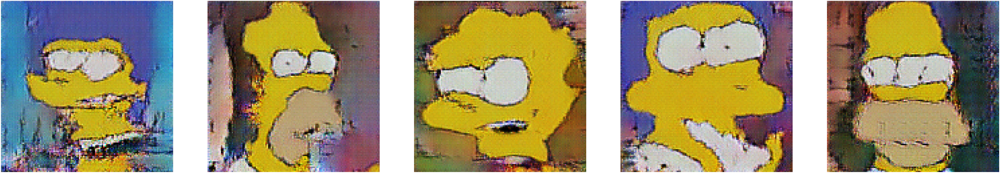

Epoch 41/50 
Duration: 145.21960 
D Loss: 0.44094 
G Loss: 1.43288


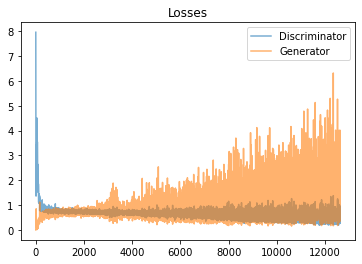

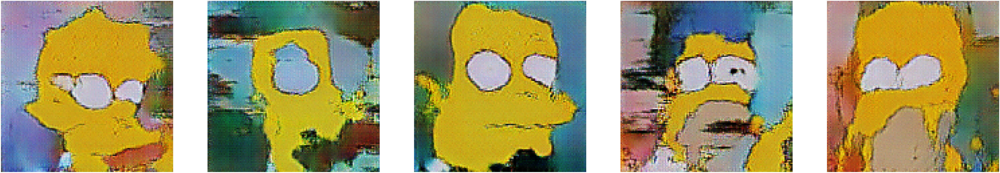

Epoch 42/50 
Duration: 145.42154 
D Loss: 0.41631 
G Loss: 1.48109


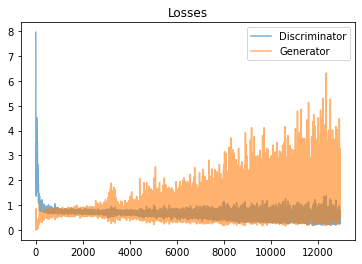

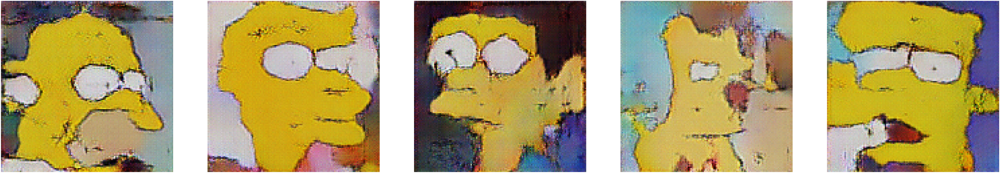

Epoch 43/50 
Duration: 145.57049 
D Loss: 0.40962 
G Loss: 1.54778


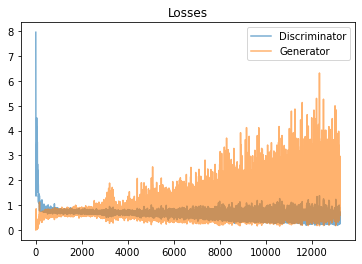

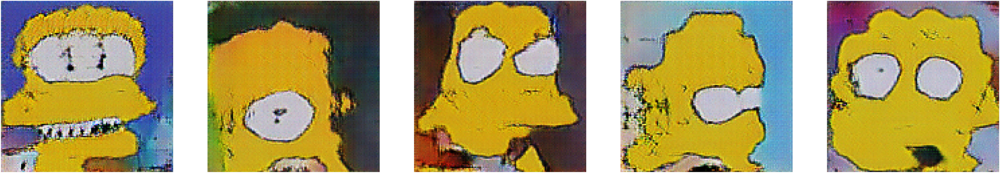

Epoch 44/50 
Duration: 144.48227 
D Loss: 0.40640 
G Loss: 1.60460


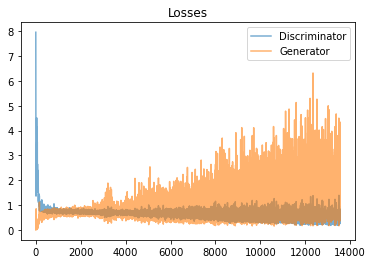

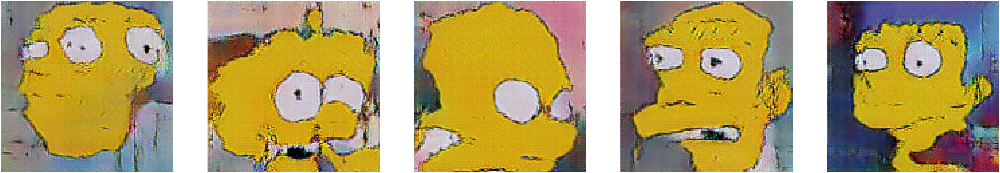

Epoch 45/50 
Duration: 145.67667 
D Loss: 0.41344 
G Loss: 1.57623


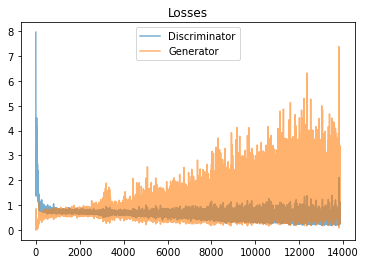

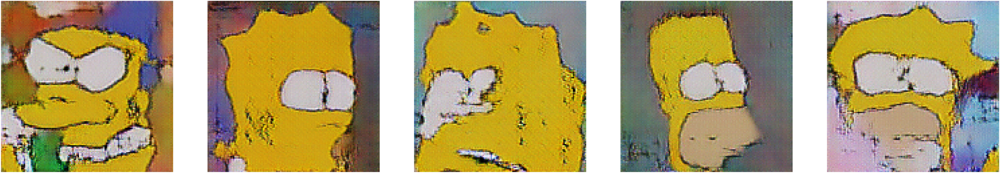

Epoch 46/50 
Duration: 144.50326 
D Loss: 0.38825 
G Loss: 1.59811


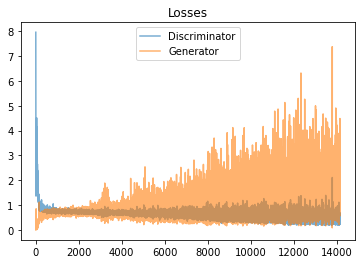

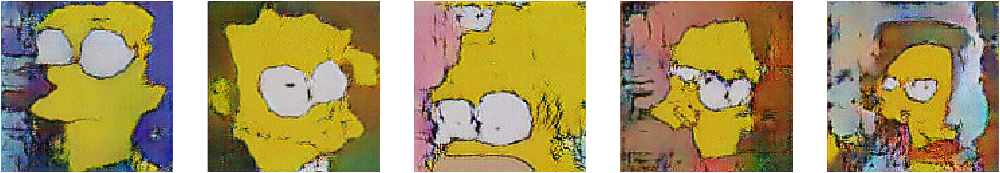

Epoch 47/50 
Duration: 144.48822 
D Loss: 0.38400 
G Loss: 1.63298


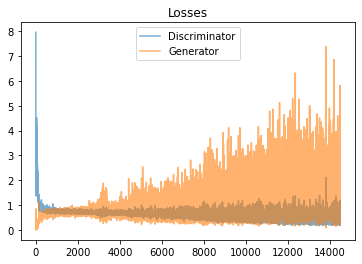

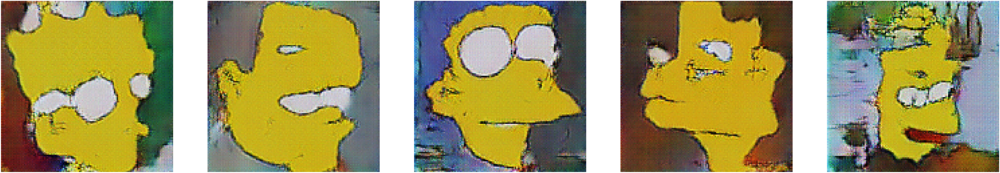

Epoch 48/50 
Duration: 144.47983 
D Loss: 0.37289 
G Loss: 1.70205


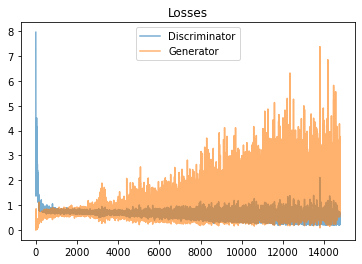

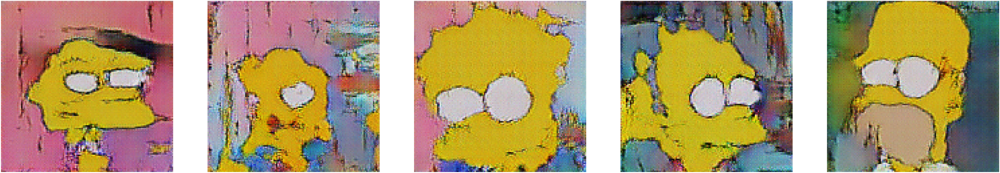

Epoch 49/50 
Duration: 144.56558 
D Loss: 0.36946 
G Loss: 1.78402


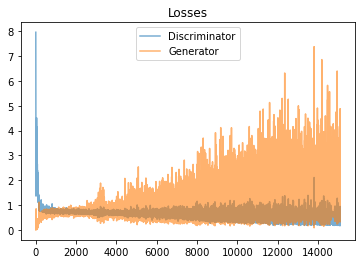

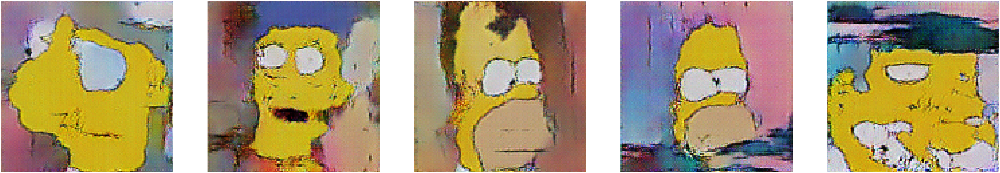

Epoch 50/50 
Duration: 144.46321 
D Loss: 0.38883 
G Loss: 1.73560


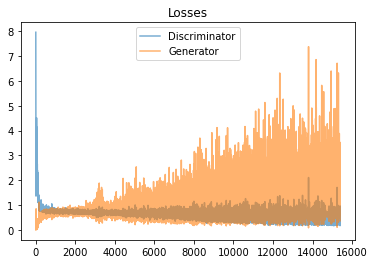

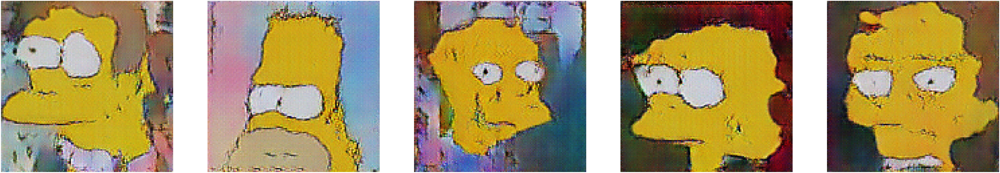

In [19]:
print("Starting the training")
input_images = np.asarray([np.asarray(Image.open(file).resize((IMAGE_SIZE, IMAGE_SIZE))) for file in glob(INPUT_DATA_DIR + '*')])
print ("Input: " + str(input_images.shape))

np.random.shuffle(input_images)

sample_images = random.sample(list(input_images), SAMPLES_TO_SHOW)
show_samples(sample_images, OUTPUT_DIR + "inputs", 0)

with tf.Graph().as_default():
    train(get_batches(input_images), input_images.shape)